<div align="center">
<img src="https://javier.rodriguez.org.mx/itesm/2014/tecnologico-de-monterrey-blue.png" width="300"/>
</div>

<div align="center" style="margin-top:50px">Modelación de sistemas multiagentes con gráficas computacionales</div>

<h1 align="center">Actividad Integradora</h1>

<div align="center">
Presenta:
<br>
David René Langarica Hernández - A01708936
</div>

<div align="center" style="margin-top: 20px;">
Profesores:
<br>
Pedro Oscar Pérez Murueta
<br>
Alejandro Fernández
<br>
Denisse Lizbeth Maldonado Flores
</div>

<div align="center" style="margin-top: 20px; margin-bottom: 50px;">
Fecha:
<br>
19 de noviembre de 2023
</div>

## Problema

Felicidades! Eres el orgulloso propietario de 5 robots nuevos y un almacén lleno de cajas. El dueño anterior del almacén lo dejó en completo desorden, por lo que depende de tus robots organizar las cajas en algo parecido al orden y convertirlo en un negocio exitoso.

Cada robot está equipado con ruedas omnidireccionales y, por lo tanto, puede conducir en las cuatro direcciones. Pueden recoger cajas en celdas de cuadrícula adyacentes con sus manipuladores, luego llevarlas a otra ubicación e incluso construir pilas de hasta cinco cajas. Todos los robots están equipados con la tecnología de sensores más nueva que les permite recibir datos de sensores de las cuatro celdas adyacentes. Por tanto, es fácil distinguir si un campo está libre, es una pared, contiene una pila de cajas (y cuantas cajas hay en la pila) o está ocupado por otro robot. Los robots también tienen sensores de presión equipados que les indican si llevan una caja en ese momento.

Lamentablemente, tu presupuesto resultó insuficiente para adquirir un software de gestión de agentes múltiples de última generación. Pero eso no debería ser un gran problema ... ¿verdad? Tu tarea es enseñar a sus robots cómo ordenar su almacén. La organización de los agentes depende de ti, siempre que todas las cajas terminen en pilas ordenadas de cinco.

Puntos a considerar
•	La semilla para generación de números aleatorios será 67890.
•	El almacén es 20x20 celdas.
•	Al inicio de la simulación, tu solución deberá colocar 200 cajas repartidas en grupos de 1 a 3 cajas en posiciones aleatorias.
•	Todos los robots empiezan en posiciones aleatorias vacías. Y, sólo puede haber un robot por celda.
•	La simulación termina cuando todas las cajas se encuentra apiladas en pilas de exactamente 5 cajas.

## Descripción de la estrategia y mecanismos de la solución

Para resolver el problema se utilizó una estrategia en la cual se recorre el almacén hasta que todas las cajas hayan sido apiladas en pilas de máximo 5 cajas. 

Con este objetivo, se busca la caja más cercana a la posición actual del robot. Una vez que se encuentra la caja, el robot se mueve a la posición de la caja y la recoge. Después, se busca la pila más cercana a la posición actual del robot en la que se pueda colocar la caja. Una vez que se encuentra la posición, el robot se mueve a la posición de la pila y coloca la caja.

En caso de que el robot no encuentre una caja o una pila, se mueve a una posición aleatoria. Esto se hace para evitar que el robot se quede atorado en un lugar sin poder moverse. Del mismo modo, se agrega una validación para que este no se mueva a una posición en la que ya se encuentre otro robot.

Para poder visualizar la simulación y rastrear la ubicación de los robots, las cajas y las pilas, se crearon 3 tipos de agentes diferentes y a cada uno se le asignó un color diferente. Los agentes son los siguientes:

- Robot: Se encarga de recorrer el almacén, recoger las cajas y colocarlas en las pilas.
- Caja: Se encarga de representar las cajas que se encuentran en el almacén.
- Pila: Se encarga de representar las pilas de cajas que se encuentran en el almacén.

## Solución

In [21]:
from mesa import Agent, Model
from mesa.space import MultiGrid
from mesa.time import RandomActivation
from mesa.datacollection import DataCollector
import numpy as np
import random
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [22]:
class Box(Agent):
    def __init__(self, id, model, pos):
        """
        Constructor for the Box class.
        
        Args:
        -----
            id: Unique identifier for the agent.
            model: Model in which the agent is instantiated.
            pos: Position of the agent in the grid.
        """
        super().__init__(id, model)
        self.pos = pos

In [23]:
class Stack(Agent):
    def __init__(self, id, model, pos):
        """
        Constructor for the Stack class.
        
        Args:
        -----
            id: Unique identifier for the agent.
            model: Model in which the agent is instantiated.
            pos: Position of the agent in the grid.
        """
        super().__init__(id, model)
        self.pos = pos
        self.boxes = []

    def add_box(self, box):
        """
        The add_box method adds a box to the stack.
        
        Args:
        -----
            box: Box to be added to the stack.
        """
        self.boxes.append(box)

    
    def is_full(self):
        """
        The is_full method checks if the stack is full.
        
        Returns:
        --------
            True if the stack is full, False otherwise.
        """
        return len(self.boxes) == self.model.num_boxes_per_stack

In [24]:
class RobotAgent(Agent):
    def __init__(self, id, model):
        """
        Constructor for the RobotAgent class.
        
        Args:
        -----
            id: Unique identifier for the agent.
            model: Model in which the agent is instantiated.
        """
        super().__init__(id, model)
        self.holding_box = False

    def find_nearest_incomplete_stack(self):
        """
        The find_nearest_incomplete_stack method finds the nearest incomplete stack.
        
        Returns:
        --------
            The nearest incomplete stack if there is one, None otherwise.
        """
        incomplete_stacks = [
            stack for stack in self.model.stacks if not stack.is_full()
        ]
        if not incomplete_stacks:
            return None

        closest_stack = min(
            incomplete_stacks, key=lambda stack: self.distance_to(stack.pos)
        )
        return closest_stack

    def distance_to_target(self, pos, target_pos):
        """
        The distance_to_target method calculates the distance between two positions.
        
        Args:
        -----
            pos: First position.
            target_pos: Second position.
            
        Returns:
        --------
            The distance between the two positions.
        """
        distance_x, distance_y = pos[0] - target_pos[0], pos[1] - target_pos[1]
        return abs(distance_x) + abs(distance_y)
    
    def distance_to(self, pos):
        """
        The distance_to method calculates the distance between the agent and a position.
        
        Args:
        -----
            pos: Position.
            
        Returns:
        --------
            The distance between the agent and the position.
        """
        distance_x, distance_y = self.pos[0] - pos[0], self.pos[1] - pos[1]
        return abs(distance_x) + abs(distance_y)

    def move_towards(self, target_pos):
        """
        The move_towards method moves the agent towards a position.
        
        Args:
        -----
            target_pos: Position to move towards.
        """
        possible_steps = self.model.grid.get_neighborhood(
            self.pos, moore=False, include_center=False
        )
        
        best_step = min(
            possible_steps, key=lambda pos: self.distance_to_target(pos, target_pos)
        )
        self.model.grid.move_agent(self, best_step)

    def move(self):
        """
        The move method moves the agent. If it is holding a box, it moves towards
        the nearest incomplete stack, otherwise it moves to a random empty cell.
        """
        if self.holding_box:
            nearest_stack = self.find_nearest_incomplete_stack()
            if nearest_stack:
                self.move_towards(nearest_stack.pos)
        else:
            possible_steps = self.model.grid.get_neighborhood(
                self.pos, moore=False, include_center=False
            )
            possible_steps = [
                step for step in possible_steps if self.model.grid.is_cell_empty(step)
            ]

            if possible_steps:
                new_position = self.random.choice(possible_steps)
                self.model.grid.move_agent(self, new_position)

    def pick_up_box(self):
        """
        The pick_up_box method picks up a box from an adjacent cell if there is one.
        """
        if not self.holding_box:
            neighbors = self.model.grid.get_neighborhood(
                self.pos, moore=False, include_center=False
            )
            for neighbor_pos in neighbors:
                box = next(
                    (box for box in self.model.boxes if box.pos == neighbor_pos), None
                )
                if box:
                    self.holding_box = box
                    self.model.boxes.remove(box)
                    self.model.grid.remove_agent(box)
                    break

    def stack_box(self):
        """
        The stack_box method stacks a box in an adjacent incomplete stack if there is one.
        If there is no incomplete stack, it creates a new one, otherwise it moves to the
        nearest empty cell.
        """
        if self.holding_box:
            nearest_stack = self.find_nearest_incomplete_stack()
            if (
                nearest_stack
                and self.distance_to(nearest_stack.pos) <= 1
                and not nearest_stack.is_full()
            ):
                nearest_stack.add_box(self.holding_box)
                self.holding_box = None

            elif not nearest_stack:
                id = "stack-" + str(self.model.next_stack_id)
                new_stack = Stack(id, self.model, self.pos)
                new_stack.add_box(self.holding_box)
                self.model.stacks.append(new_stack)
                self.model.grid.place_agent(new_stack, self.pos)
                self.holding_box = None

    def step(self):
        """
        The step method is called by the scheduler in order to execute the
        agent's actions.
        """
        self.move()
        self.pick_up_box()
        self.stack_box()

In [25]:
def get_grid(model):
    """
    The get_grid function returns a grid with the state of the model.
    
    Args:
    -----
        model: Model from which the grid is generated.
        
    Returns:
    --------
        A grid with the state of the model.
    """
    grid = np.zeros((model.grid.width, model.grid.height))
    for content, (x, y) in model.grid.coord_iter():
        cell_value = 0
        for agent in content:
            if isinstance(agent, RobotAgent):
                if agent.holding_box:
                    cell_value = 2
                else:
                    cell_value = 1
            elif isinstance(agent, Box):
                cell_value = 3
            elif isinstance(agent, Stack):
                if agent.is_full():
                    cell_value = 5
                else:
                    cell_value = 4
        grid[x][y] = cell_value
    return grid

In [26]:
class WarehouseModel(Model):
    def __init__(self, width, height, num_robots, num_boxes, num_boxes_per_stack):
        """
        Constructor for the WarehouseModel class.
        
        Args:
        -----
            width: Width of the grid.
            height: Height of the grid.
            num_robots: Number of robots to instantiate.
            num_boxes: Number of boxes to instantiate.
            num_boxes_per_stack: Number of boxes per stack.
        """
        super().__init__()
        self.grid = MultiGrid(width, height, torus=False)
        self.schedule = RandomActivation(self)
        self.datacollector = DataCollector(model_reporters={"Grid": get_grid})
        self.next_stack_id = 0
        self.boxes_locations = set()
        self.stacks_locations = {}
        self.stacks = []
        self.num_boxes_per_stack = num_boxes_per_stack

        self.initialize_boxes(num_boxes)
        self.initialize_robots(num_robots)

    def initialize_boxes(self, num_boxes):
        """
        The initialize_boxes method instantiates the boxes in random positions.
        
        Args:
        -----
            num_boxes: Number of boxes to instantiate.
        """
        self.boxes = []
        placed_boxes = 0
        while placed_boxes < num_boxes:
            x, y = self.random_position()
            if self.grid.is_cell_empty((x, y)):
                box_count = np.random.choice([1, 2, 3], p=[0.5, 0.3, 0.2])
                box_count = min(box_count, num_boxes - placed_boxes)
                for _ in range(box_count):
                    id = "box-" + str(self.next_id())
                    box = Box(id, self, (x, y))
                    self.boxes.append(box)
                    self.grid.place_agent(box, (x, y))
                    placed_boxes += 1

    def random_position(self):
        """
        The random_position method returns a random position in the grid.
        
        Returns:
        --------
            A random position in the grid.
        """
        return (
            self.random.randrange(self.grid.width),
            self.random.randrange(self.grid.height),
        )

    def initialize_robots(self, num_robots):
        """
        The initialize_robots method instantiates the robots in random positions.
        
        Args:
        -----
            num_robots: Number of robots to instantiate.
        """
        for _ in range(num_robots):
            while True:
                x, y = self.random_position()
                if self.grid.is_cell_empty((x, y)):
                    id = "robot-" + str(self.next_id())
                    robot = RobotAgent(
                        id, self
                    )
                    self.grid.place_agent(robot, (x, y))
                    self.schedule.add(robot)
                    break

    def all_boxes_stacked(self):
        """
        The all_boxes_stacked method checks if all the boxes have been stacked.
        
        Returns:
        --------
            True if all the boxes have been stacked, False otherwise.
        """
        return all(stack.is_full() for stack in self.stacks) and not self.boxes

    def step(self):
        """
        The step method is called by the scheduler in order to execute the
        model's actions.
        """
        self.datacollector.collect(self)
        self.schedule.step()
        if self.all_boxes_stacked():
            self.running = False

In [27]:
WIDTH = 20
HEIGHT = 20
NUM_ROBOTS = 5
NUM_BOXES = 200
NUM_BOXES_PER_STACK = 5
RANDOM_SEED = 67890

random.seed(RANDOM_SEED)

model = WarehouseModel(WIDTH, HEIGHT, NUM_ROBOTS, NUM_BOXES, NUM_BOXES_PER_STACK)

while model.running:
    model.step()

print("Número de pasos:", model.schedule.steps)
print("Número de pilas:", len(model.stacks))
print("Número de cajas sin pila:", len(model.boxes))

Número de pasos: 2947
Número de pilas: 40
Número de cajas sin pila: 0


In [28]:
all_grid = model.datacollector.get_model_vars_dataframe()

## Visualización

C:\Users\david\AppData\Local\Temp\ipykernel_7316\2309525664.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  patch = plt.imshow(all_grid.iloc[0][0], cmap="terrain", vmin=0, vmax=6)
C:\Users\david\AppData\Local\Temp\ipykernel_7316\2309525664.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  patch.set_data(all_grid.iloc[i][0])


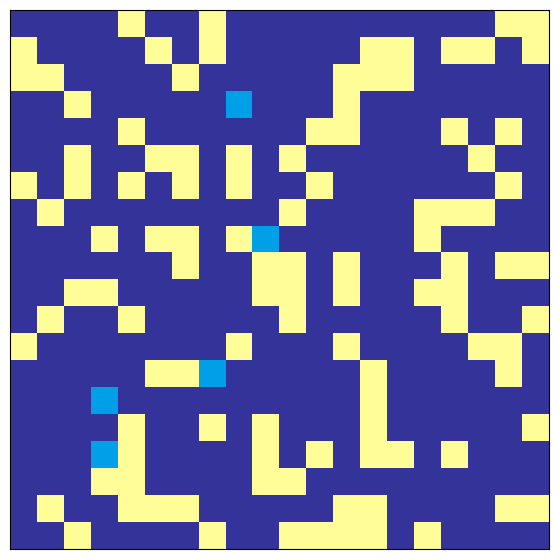

In [29]:
fig, axs = plt.subplots(figsize=(7, 7))
axs.set_xticks([])
axs.set_yticks([])
patch = plt.imshow(all_grid.iloc[0][0], cmap="terrain", vmin=0, vmax=6)

def animate(i):
    patch.set_data(all_grid.iloc[i][0])
    
anim = animation.FuncAnimation(fig, animate, frames=len(all_grid))

In [30]:
anim

C:\Users\david\AppData\Local\Temp\ipykernel_7316\2309525664.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  patch.set_data(all_grid.iloc[i][0])


## ¿Existe una forma de reducir el número de pasos?

Actualmente, a la simulación le toma aproximadamente 3000 pasos en promedio para apilar todas las cajas, lo cual es un número que considero bueno con relación al tamaño del espacio y mi experiencia en el área, pero que aún y así aún tanto alto y que podría ser reducido un poco.

Una de las estrategias que se me ocurre para reducirlo es que, tomando en cuenta que las cajas pueden comenzar en grupos de 1 a 3 y son 5 robots, 3 de esos robots podrían comenzar a buscar cajas que estén en grupos de 3, mientras que los otros 2 podrían comenzar a buscar cajas en grupos de 2 y ya que todos los grupos han sido cubiertos, todos los robots podrían dividirse para concentrarse en las cajas que están individualmente e ir directamente por ellas, para que cada uno pueda llevarse una caja y posteriormente todos los robots se dirijan a la misma pila y as apilen en una sola hasta que esta esté hasta su máximo número de cajas.

De esta forma, considero que se podría reducir el número de pasos que le toma a los robots encontrar las cajas y, por lo tanto, el número de pasos que le toma a la simulación terminar. Esto se podría lograr implementando un algoritmo de búsqueda que le permita a los robots encontrar las cajas de forma más eficiente y que siempre pueda encontrar 1 procurando que estas no estén tan dispersas.